# DIP Assignment 3

### Requirements :-
##### Libraries:-
* Numpy
* os
* Python 3.x
* scikit-image
* matplotlib
* math
* mpl_toolkits.axes_grid1
* time
* scipy

### To run this notebook successfully, please ensure the following steps.
* Ensure that all the libraries mentioned above are installed
* Ensure that in the current working directory the folder **A3_resources** and its entire folder structure exists and is maintained. **This is the input data to notebook.**



###### Note:-
* ***If any of the steps are missing/files are missing, then some parts of the code may or may not work***
* *The Results folder contains some outputs saved from the script*

In [72]:
# Importing libraries
import numpy as np
import os,cmath
import skimage
import matplotlib
import matplotlib.pyplot as plt
from numpy.fft import fft,fft2,ifft,ifft2,fftshift,ifftshift
from math import sqrt,exp,pi,cos,sin
from mpl_toolkits.axes_grid1 import make_axes_locatable
import matplotlib.cm as cm
import cv2
from time import time
from matplotlib.image import imread
from scipy.ndimage.interpolation import rotate
from matplotlib.colors import LogNorm
from scipy.signal import convolve2d
from scipy.ndimage import gaussian_filter
plt.rcParams["figure.figsize"] = (15,15)
plt.rcParams["figure.dpi"] = 40
%matplotlib inline

## *Assets*

In [73]:
def rgb2gray(image):
    '''
    A function that takes in input an image and returns its greyscale version
    '''
    if (len(image.shape)==2):
        return image
    elif (len(image.shape)==3):
        r = image[:,:,0]
        g = image[:,:,1]
        b = image[:,:,2]
        output = 0.2989 * r + 0.5870 * g + 0.1140 * b
        return output

In [74]:
def filter2D(image, kernel):
    '''
    '''
    image = image.astype('float32')
    if (len(image.shape)==2):
        (imr,imc) = image.shape
        (kr,kc) = kernel.shape
        padr = (kr)//2
        padc = (kc)//2
        pad_im = np.zeros([imr+kr-1,imc+kc-1])
        pad_im[0:imr, 0:imc] = image
        output = np.zeros(image.shape)
        for i in range(0,imr):
            for j in range(0,imc):
                output[i,j] = np.sum(np.multiply(pad_im[i:i+kr,j:j+kc],kernel))
        
        output = np.clip(output,0,255)
        return (output)

In [75]:
# Input data
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/bricks.jpg')
bricks = imread(file)
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/lena.jpg')
lena = imread(file)
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/land.png')
land = imread(file)
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/rectangle.jpg')
rectangle = imread(file)

In [76]:
def saltpepper(image):
    row,col = image.shape
    s_vs_p = 0.5
    amount = 0.04
    out = np.copy(image)
    num_salt = np.ceil(amount * image.size * s_vs_p)
    coords = [np.random.randint(0, i - 1, int(num_salt))for i in image.shape]
    out[coords] = np.amax(image)
    num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))
    coords = [np.random.randint(0, i - 1, int(num_pepper))for i in image.shape]
    out[coords] = 0
    return out

## Question 1

**Part - 1** *Implement 1D Fast Fourier Transform (Recursive Formulation).*

In [77]:
def fft1Dmain(x,method = 'standard'):
    '''
    '''
    x = x.astype('complex')
    n = x.shape[0]
    if method == 'inv':
        flag = -1
    elif method == 'standard':
        flag = 1
    
    if n==1:
        return x
    
    w = flag*np.r_[[1.0+1.0j]*n]
    for k in range(n):
        w[k] = cos(2.0*pi*k/n)-1.0j*sin(2.0*pi*k/n)
    m = n//2
    x_e = np.ones(m, complex)*1j
    x_o = np.ones(m, complex)*1j
    for i in range(m):
        x_e[i] = x[2*i]
        x_o[i] = x[2*i+1]
    
    x_e = fft1D(x_e,method)
    x_o = fft1D(x_o,method)
    
    output = np.ones([n,1], dtype ='float')*1j
    for k in range(n//2):
        output[k] = x_e[k] + w[k]*x_o[k]
        output[k+n//2] = x_e[k] - w[k]*x_o[k]
    return output        

In [78]:
def fft1D(x,method = 'standard'):
    output = fft1Dmain(x,method)
    if method == 'inv':
        print(x.shape)
        return output/x.size
    elif method == 'standard':
        return output

In [79]:
x = np.array([1,0,1,0,1,0,1,0])
output1D = np.fft.fft(x)
print(output1D)
print(fft1D(x).T)
rmse = np.sqrt(np.mean((output1D-fft1D(x).T)**2))
print(np.allclose(fft(x),fft1D(x).T))
print('rmse = ',rmse)

[4.+0.j 0.+0.j 0.+0.j 0.+0.j 4.+0.j 0.+0.j 0.+0.j 0.+0.j]
[[4.+0.j 0.+0.j 0.+0.j 0.+0.j 4.+0.j 0.+0.j 0.+0.j 0.+0.j]]
True
rmse =  0j


**Part - 2** *Use it to implement 2D FFT and display the result on suitable images of your
choice.*

In [80]:
def fft2D(x):
    x = rgb2gray(x)
    r,c = x.shape
    rowfft = np.zeros(x.shape, complex)
    op = np.zeros(x.shape, complex)
    for i in range(c):
        rowfft[:,i] = fft1D(x[:,i]).ravel()
    for i in range(r):
        op[i,:] = fft1D(rowfft[i,:]).ravel()
    return op

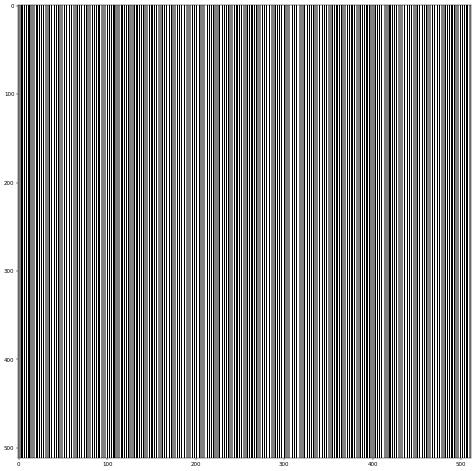

In [81]:
size = 512
f = 20000
sin_vert = np.zeros([size,size],float)
for i in range(size):
    sin_vert[:,i] = np.round(sin(2*pi*f*i/1024))
    
plt.figure(figsize = [15,15], dpi = 40)
plt.imshow(sin_vert*255,cmap = cm.gray)
plt.show()

In [82]:
fft_sin = fft2D(sin_vert)

True


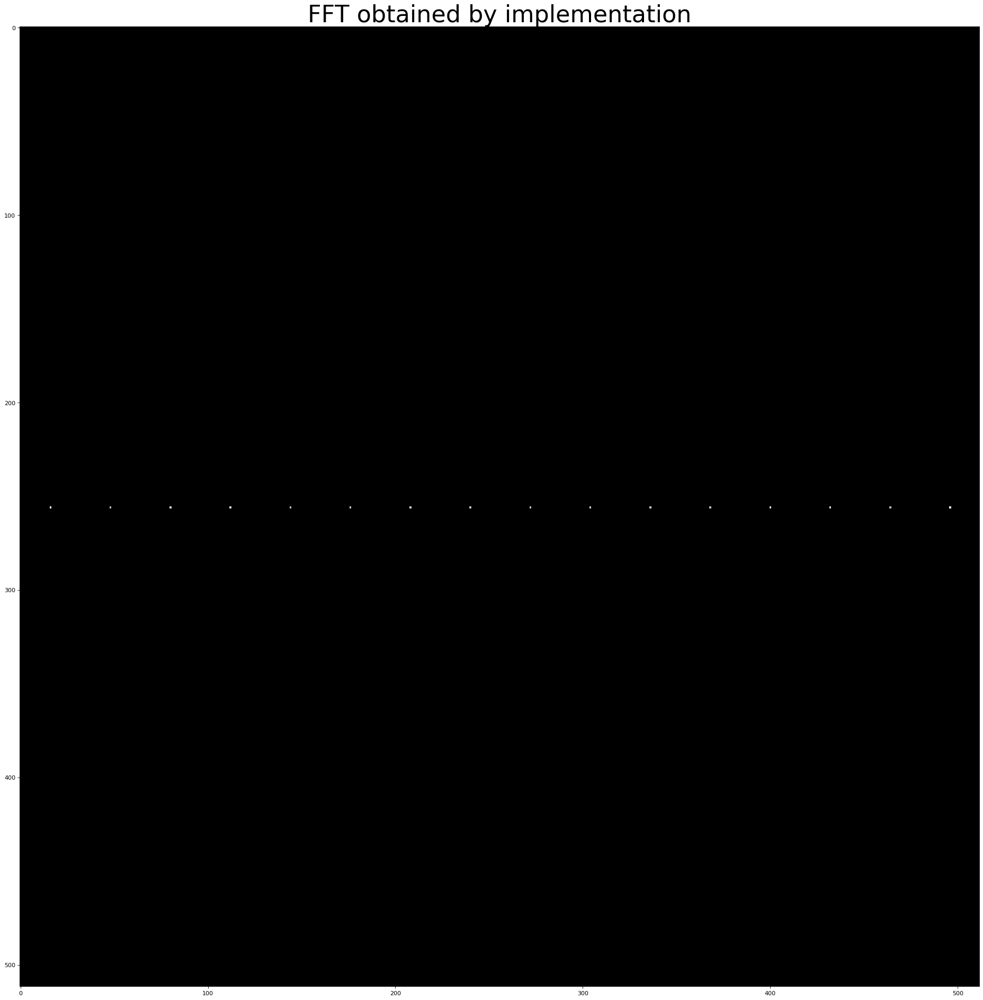

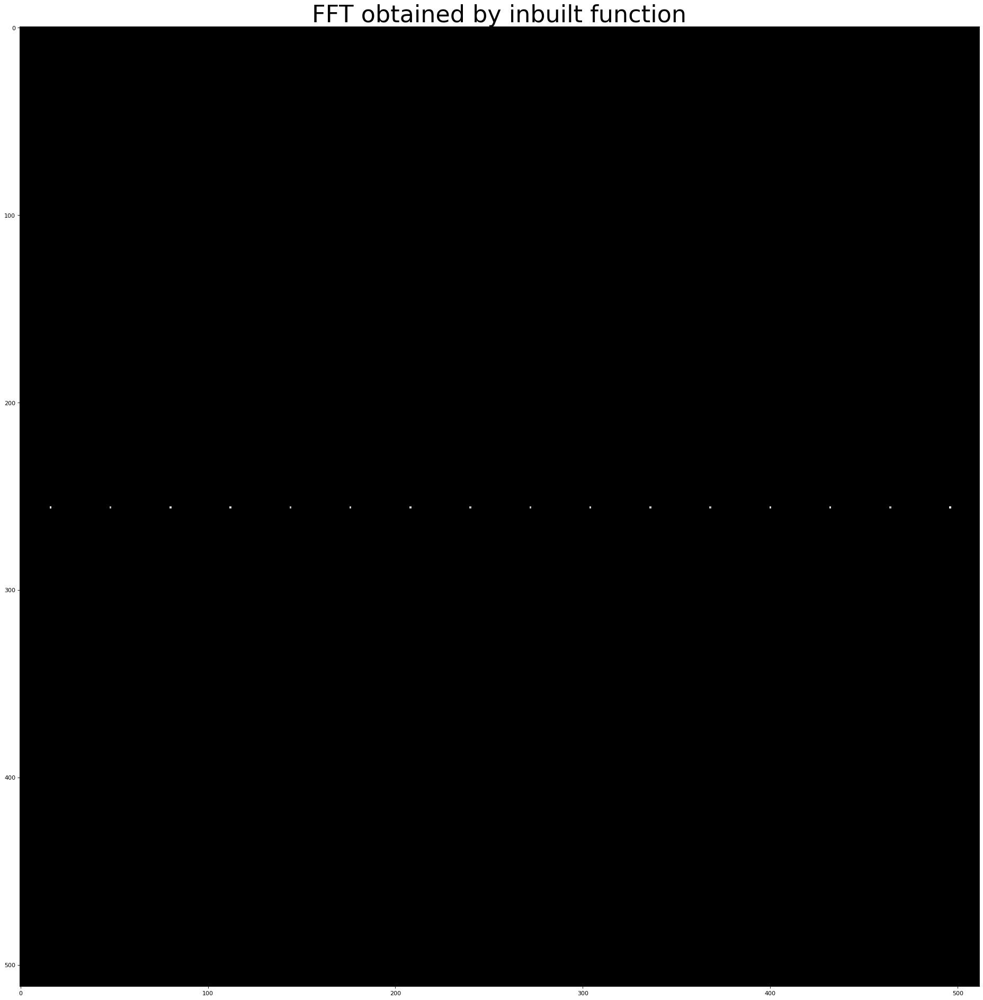

In [83]:
print(np.allclose(fft_sin, fft2(sin_vert)))
plt.figure(figsize=[30,30],dpi = 80)
plt.imshow(20*np.log(1+np.abs(fftshift(fft_sin))),cmap = 'gray')
plt.title('FFT obtained by implementation', fontsize = 40)
plt.figure(figsize=[30,30],dpi = 80)
plt.imshow(20*np.log(1+np.abs(fftshift(fft2(sin_vert)))),cmap='gray')
plt.title('FFT obtained by inbuilt function', fontsize = 40)
plt.show()

## Question 2

**Part - 1** *Implement the Ideal, Butterworth and Gaussian Low Pass Filters and
apply them on lena.jpg.*

In [84]:
def butter1D(x, cf, N=2, ax=1):
    '''
    X = freq domain transform of input signal
    cf = cutoff frequecy
    N = order
    '''
    X = np.zeros(x.shape,dtype = np.complex_)
    if (ax == 1):
        for i in range(x.shape[0]):
            X[i,:] = fft(x[i,:])
    elif (ax == 2):
        for i in range(x.shape[1]):
            X[:,i] = fft(x[:,i])    
    if (len(X.shape)%2 > 0):
        raise ValueError('Ensure that frequency transform is two dimensional only')
    else:
        m,n = X.shape
        D = np.zeros(X.shape,dtype = np.float64)
        output = np.complex128(np.zeros(X.shape, dtype = np.complex_))
        for i in range(X.shape[0]):
            for j in range(X.shape[1]):
                D[i,j] = sqrt((i-m/2)**2+(j-n/2)**2)
                output[i,j] = 1/(1+(D[i,j]/cf)**(2*N))
        
        output = np.multiply(X,output)
        filtout = np.zeros(x.shape,dtype = np.complex_)
        if (ax == 1):
            for i in range(x.shape[0]):
                filtout[i,:] = ifft(output[i,:])
        elif (ax == 2):
            for i in range(x.shape[1]):
                filtout[:,i] = ifft(output[:,i])
        
        return filtout

In [85]:
def butter2D(x, cf, N=2):
    '''
    X = freq domain transform of input signal
    cf = cutoff frequecy
    N = order
    '''
    X = fftshift(fft2(x))
    if (len(X.shape)%2 > 0):
        raise ValueError('Ensure that frequency transform is two dimensional only')
    else:
        m,n = X.shape
        D = np.zeros(X.shape,dtype = np.float64)
        output = np.complex128(np.zeros(X.shape, dtype = np.complex_))
        for i in range(X.shape[0]):
            for j in range(X.shape[1]):
                D[i,j] = sqrt((i-m/2)**2+(j-n/2)**2)
                output[i,j] = 1/(1+(D[i,j]/cf)**(2*N))
        
        filtout = ifft2(ifftshift(np.multiply(X,output)))
        return filtout

In [86]:
def ideal1D(x, cf, ax=1):
    '''
    X = freq domain transform of input signal
    cf = cutoff frequecy
    '''
    X = np.zeros(x.shape,dtype = np.complex_)
    if (ax == 1):
        for i in range(x.shape[0]):
            X[i,:] = fft(x[i,:])
    elif (ax == 2):
        for i in range(x.shape[1]):
            X[:,i] = fft(x[:,i])
    
    if (len(X.shape)%2 > 0):
        raise ValueError('Ensure that frequency transform is two dimensional only')
    else:
        m,n = X.shape
        D = np.zeros(X.shape,dtype = np.float64)
        for i in range(X.shape[0]):
            for j in range(X.shape[1]):
                D[i,j] = sqrt((i-m/2)*(i-m/2)+(j-n/2)*(j-n/2))
        
        output = np.zeros(X.shape, dtype = np.complex_)
        output[D<=cf] = 1
        output[D>cf] = 0
        output = np.multiply(X,output)
        filtout = np.zeros(x.shape,dtype = np.complex_)
        if (ax == 1):
            for i in range(x.shape[0]):
                filtout[i,:] = ifft(output[i,:])
        elif (ax == 2):
            for i in range(x.shape[1]):
                filtout[:,i] = ifft(output[:,i])
        return filtout

In [87]:
def ideal2D(x, cf):
    '''
    X = freq domain transform of input signal
    cf = cutoff frequecy
    '''
    X = fftshift(fft2(x))
    if (len(X.shape)%2 > 0):
        raise ValueError('Ensure that frequency transform is two dimensional only')
    else:
        m,n = X.shape
        D = np.zeros(X.shape,dtype = np.float64)
        for i in range(X.shape[0]):
            for j in range(X.shape[1]):
                D[i,j] = sqrt((i-m/2)*(i-m/2)+(j-n/2)*(j-n/2))
        
        output = np.zeros(X.shape, dtype = np.complex_)
        output[D<=cf] = 1
        output[D>cf] = 0
        filtout = ifft2(ifftshift(np.multiply(X,output)))
        return filtout

In [88]:
def gausslow1D(x,cf,ax =1):
    '''
    X = freq domain transform of input signal
    cf = cutoff frequecy
    '''
    X = np.zeros(x.shape,dtype = np.complex_)
    if (ax == 1):
        for i in range(x.shape[0]):
            X[i,:] = fft(x[i,:])
    elif (ax == 2):
        for i in range(x.shape[1]):
            X[:,i] = fft(x[:,i])
    
    if (len(X.shape)%2 > 0):
        raise ValueError('Ensure that frequency transform is two dimensional only')
    else:
        m,n = X.shape
        D = (np.zeros(X.shape,dtype = np.float64))
        output = (np.zeros(X.shape, dtype = np.float64))
        for i in range(X.shape[0]):
            for j in range(X.shape[1]):
                D[i,j] = sqrt((i-m/2)**2+(j-n/2)**2)
                output[i,j] = exp(-1*D[i,j]**2/(2*(cf**2)))
        output = np.multiply(X,output)
        filtout = np.zeros(x.shape,dtype = np.complex_)
        if (ax == 1):
            for i in range(x.shape[0]):
                filtout[i,:] = ifft(output[i,:])
        elif (ax == 2):
            for i in range(x.shape[1]):
                filtout[:,i] = ifft(output[:,i])
        
        return filtout

In [89]:
def gausslow2D(x,cf):
    '''
    X = freq domain transform of input signal
    cf = cutoff frequecy
    '''
    X = fftshift(fft2(x))
    if (len(X.shape)%2 > 0):
        raise ValueError('Ensure that frequency transform is two dimensional only')
    else:
        m,n = X.shape
        D = (np.zeros(X.shape,dtype = np.float64))
        output = (np.zeros(X.shape, dtype = np.float64))
        for i in range(X.shape[0]):
            for j in range(X.shape[1]):
                D[i,j] = sqrt((i-m/2)**2+(j-n/2)**2)
                output[i,j] = exp(-1*D[i,j]**2/(2*(cf**2)))
        filtout = ifft2(ifftshift(np.multiply(X,output)))
        return filtout

In [90]:
lena_butter = butter2D(rgb2gray(lena),30,1)

In [91]:
lena_ideal = ideal2D(rgb2gray(lena),30)

In [92]:
lena_gauss = gausslow2D(rgb2gray(lena),30)

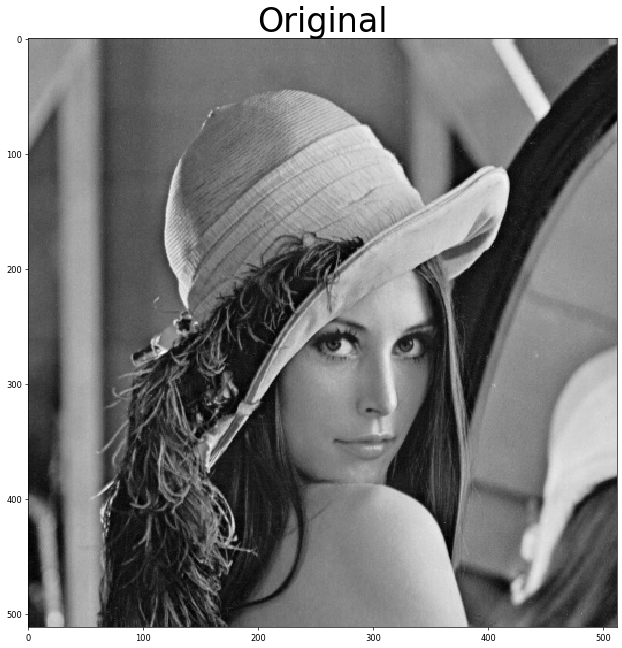

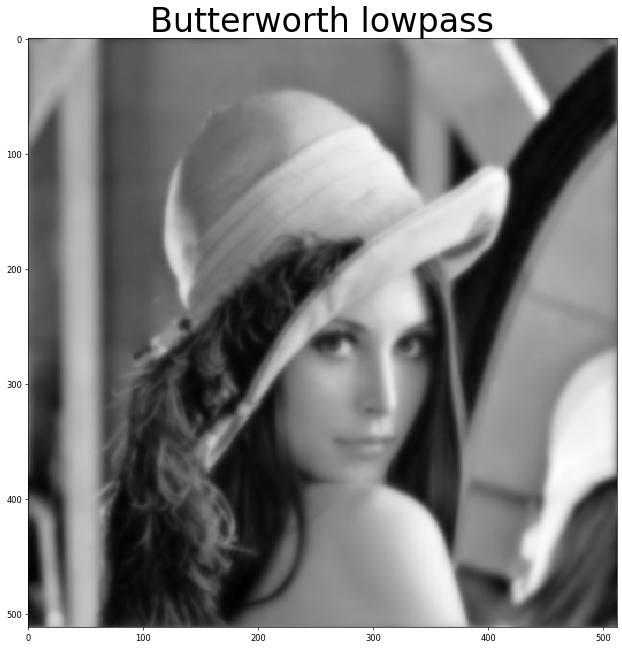

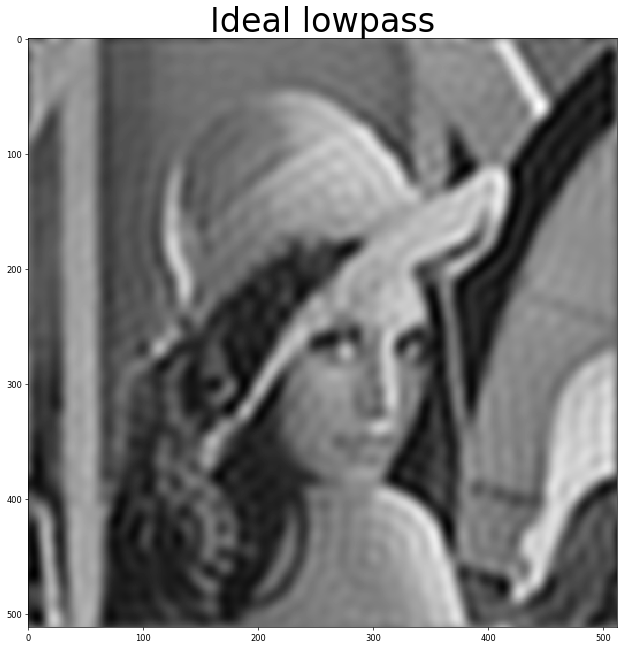

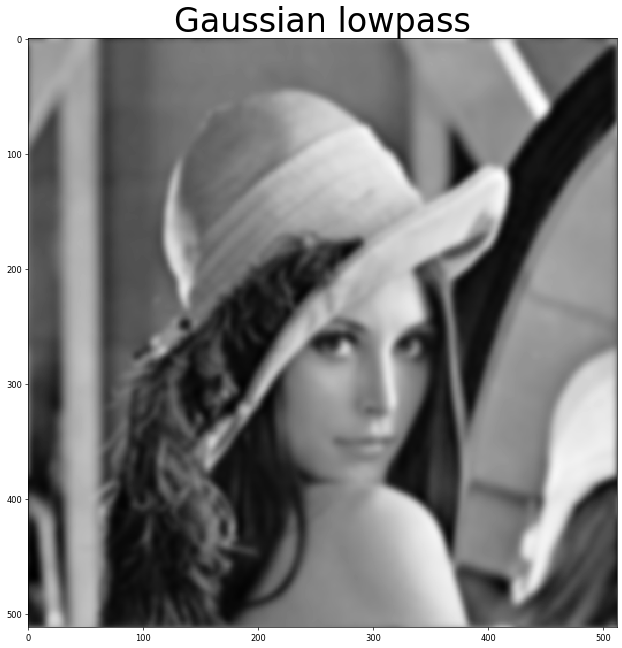

In [93]:
plt.figure(figsize = [13,13], dpi =60)
plt.imshow(rgb2gray(lena),cmap = cm.gray)
plt.title('Original', fontsize = 40)
plt.figure(figsize = [13,13], dpi =60)
plt.imshow(np.abs(lena_butter),cmap = cm.gray)
plt.title('Butterworth lowpass', fontsize = 40)
plt.figure(figsize = [13,13], dpi =60)
plt.imshow(np.abs(lena_ideal),cmap = cm.gray)
plt.title('Ideal lowpass', fontsize = 40)
plt.figure(figsize = [13,13], dpi =60)
plt.imshow(np.abs(lena_gauss),cmap = cm.gray)
plt.title('Gaussian lowpass', fontsize = 40)
plt.show()

**Part - 2** *Using lena.jpg, apply the Gaussian low pass filter with two different values of σ.
Compute the difference of the two outputs and display it. Report your observations.*

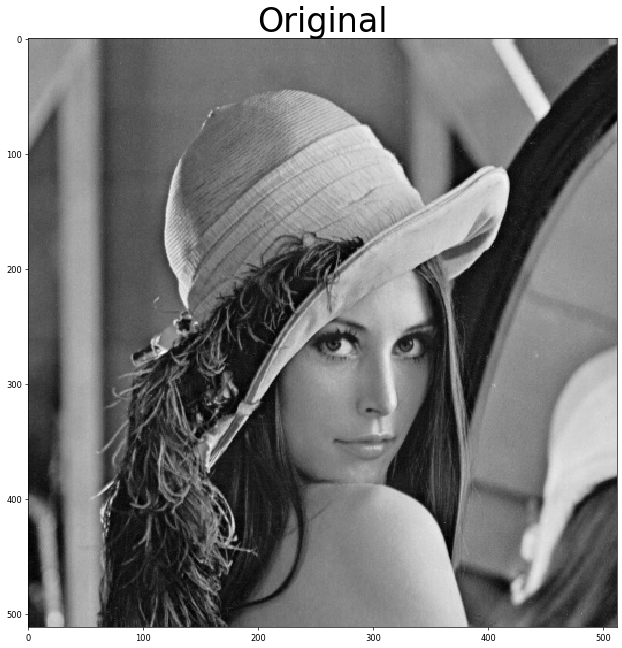

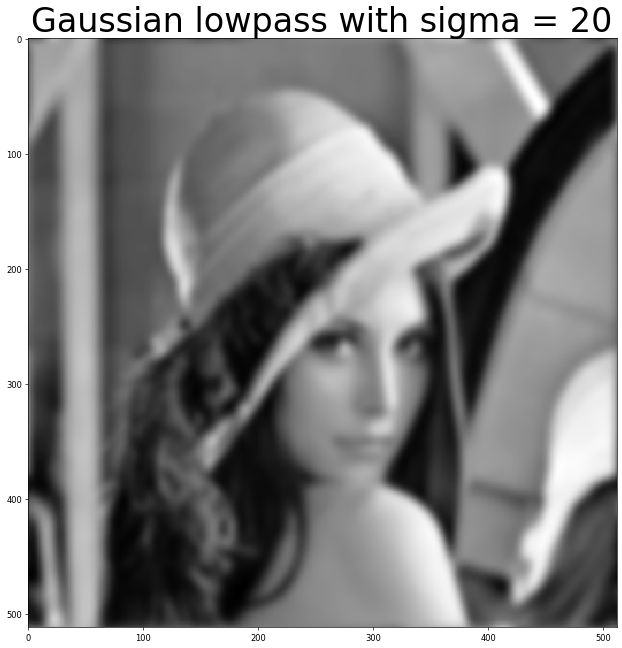

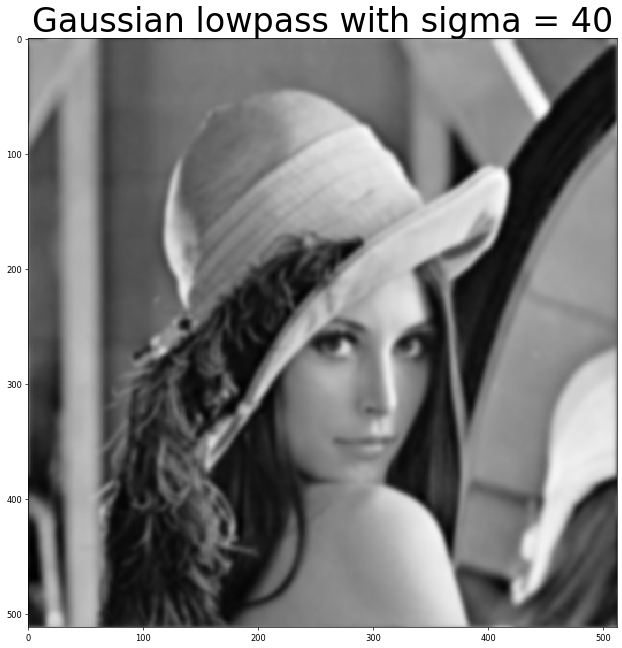

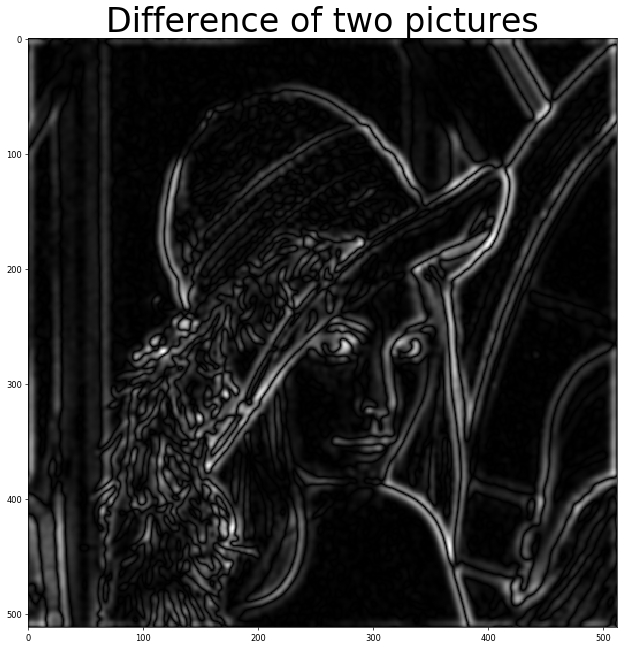

In [94]:
plt.figure(figsize = [13,13], dpi =60)
plt.imshow(rgb2gray(lena),cmap = cm.gray)
plt.title('Original', fontsize = 40)
plt.figure(figsize = [13,13], dpi =60)
sigma1 = 20
sigma2 = 40
lena_gauss1 = gausslow2D(rgb2gray(lena),sigma1)
lena_gauss2 = gausslow2D(rgb2gray(lena),sigma2)
plt.imshow(np.abs(lena_gauss1),cmap = cm.gray)
plt.title('Gaussian lowpass with sigma = %i'%sigma1, fontsize = 40)
plt.figure(figsize = [13,13], dpi =60)
plt.imshow(np.abs(lena_gauss2),cmap = cm.gray)
plt.title('Gaussian lowpass with sigma = %i'%sigma2, fontsize = 40)
plt.figure(figsize = [13,13], dpi =60)
plt.imshow(np.abs(lena_gauss2-lena_gauss1),cmap = cm.gray)
plt.title('Difference of two pictures', fontsize = 40)
plt.show()

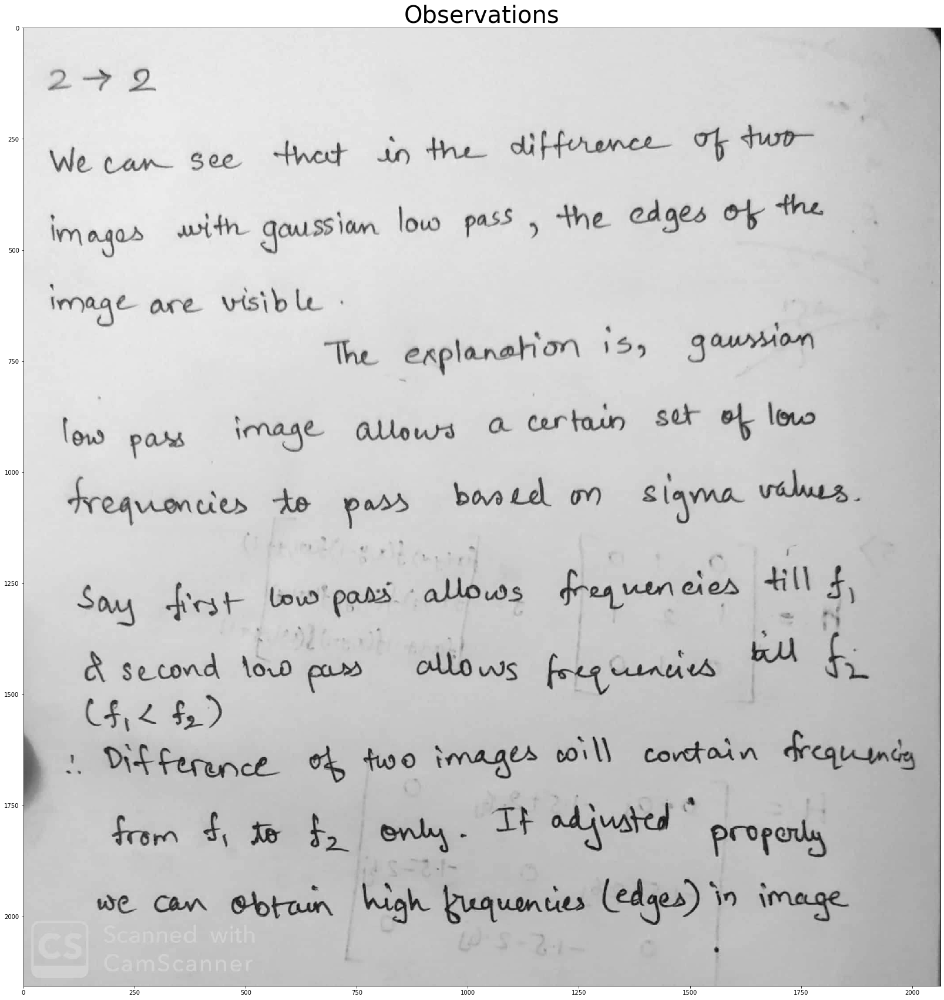

In [114]:
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/dipa3q2_2.jpg')
dipa3q2_2 = rgb2gray(imread(file))
plt.figure(figsize = [30,30])
plt.imshow(dipa3q2_2, cmap = 'gray')
plt.title('Observations', fontsize = 40)
plt.show()

## Question 3

*Say you are travelling in a bus for a city tour in Paris and you want to
capture the scene outside. Thankfully the Bus is stationary. Unfortunately, you can’t
open the window and the window acts as a semi-reflecting surface and the image contains
reflections from inside the bus :( . But Hey, you got a camera which can focus on the
outside scene by blurring the reflection off the window. This can be written as out1 =
f1 + h2 * f2 where h2 is the blurring filter applied on f2. The second image is taken
focusing the window surface, blurring the outside scene. This can be written as out2 =
h1 * f1 + f2 where h1 is the blurring filter applied on f1. You are given the two images
out1 and out2. Assuming you know h1 and h2, how would you find f1 and f2. Do you
see any issues with the formula derived?*

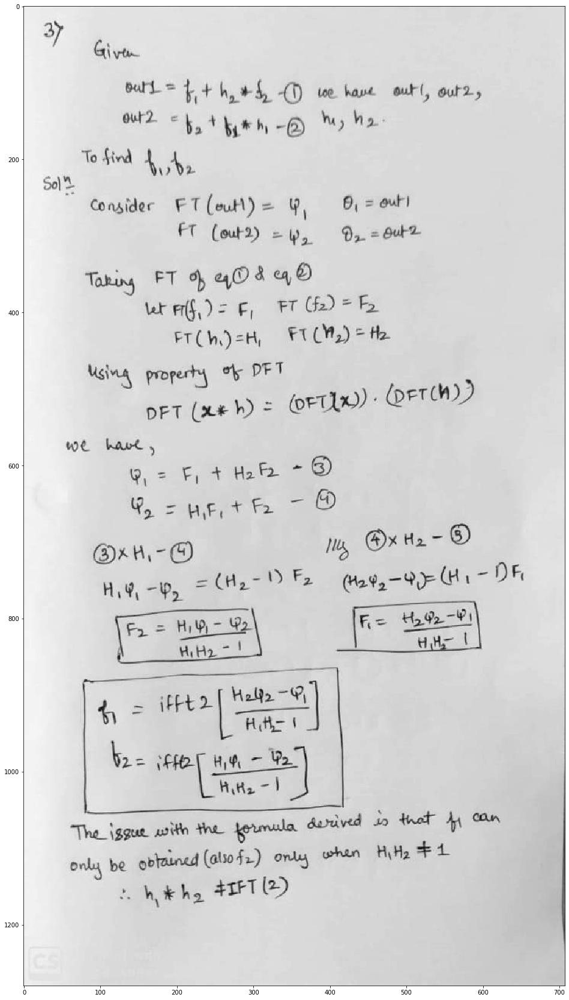

In [95]:
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/dipa3q3.jpeg')
dipa3q3 = rgb2gray(imread(file))
plt.figure(figsize = [30,30])
plt.imshow(dipa3q3, cmap = 'gray')
plt.show()

## Question 4

*Denoise the given image land.png and explain your process.*

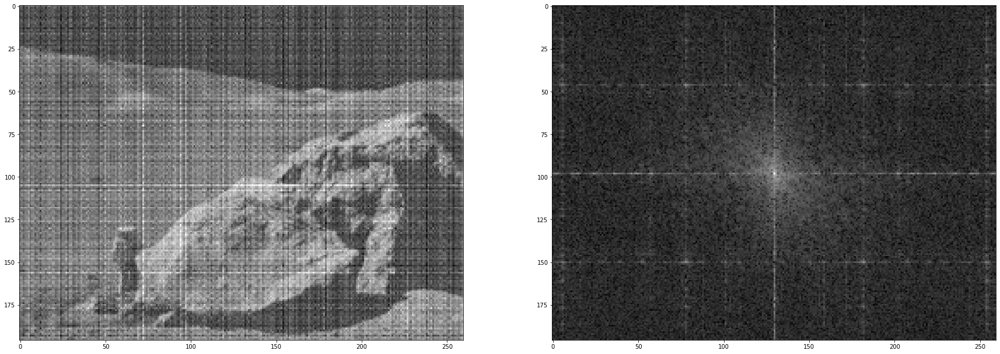

In [96]:
fig = plt.figure(figsize = [30,30])
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
land = rgb2gray(land)
land_fft = fftshift(fft2(land))
ax1.imshow(land, cmap = 'gray')
# ax2.imshow(np.log(1+np.abs(land_fft)),cmap='gray')
ax2.imshow(20*np.log(1+np.abs(land_fft)),cmap='gray')
plt.show()

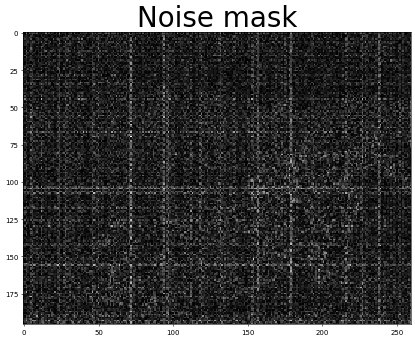

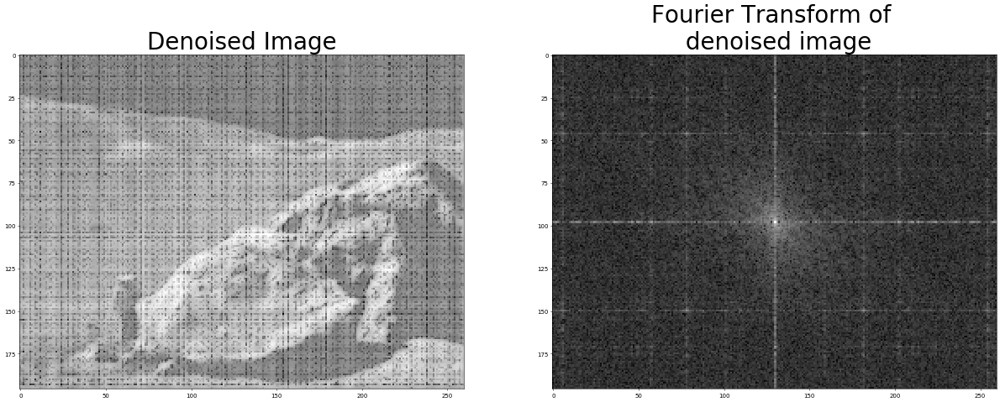

In [97]:
cfh = 200
cfl = 30
wt = 1
noise_mask = np.abs(ideal2D(land, cfl) - ideal2D(land, cfh))
denoised_land1 =  np.abs(land - wt*noise_mask)
denoised_land1_fft = fftshift(fft2(denoised_land1))
fig1 = plt.figure(figsize = [10,10], dpi = 50)
fig2 = plt.figure(figsize = [30,30], dpi = 50)
ax1 = fig1.add_subplot(111)
ax2 = fig2.add_subplot(121)
ax3 = fig2.add_subplot(122)
ax1.imshow(np.abs(noise_mask), cmap = 'gray')
ax1.set_title('Noise mask', fontsize = 40)
ax2.imshow(np.abs(denoised_land1), cmap = 'gray')
ax2.set_title('Denoised Image', fontsize = 40)
ax3.imshow(20*np.log(1+np.abs(denoised_land1_fft)),cmap='gray')
ax3.set_title('Fourier Transform of \n denoised image', fontsize = 40)
plt.show()

* We know that the noise in the image is a set of horizontal and vertical lines. 
* Generally they tend to be a result of additive sine noise at high frequency.

> *The process of denoising for this image is as follows*
<br>
<br>
    -> Using the information of bandpass, search for noise frequency from magnitude spectrum
    <br>
    -> Prepare a noise mask that tries to capture all the noise in the image(Like highboost)
    <br>
    -> Subtract the noise mask from the original image to get denoised image
    <br>



## Question 5

*Find the equivalent filter H(u, v) in the frequency domain for the following
spacial filter and show results of applying this filter on an image of your choice (in the
frequency domain):*
<br>
*Is H(u, v) a low-pass filter or a high-pass filter? Show it mathematically.*

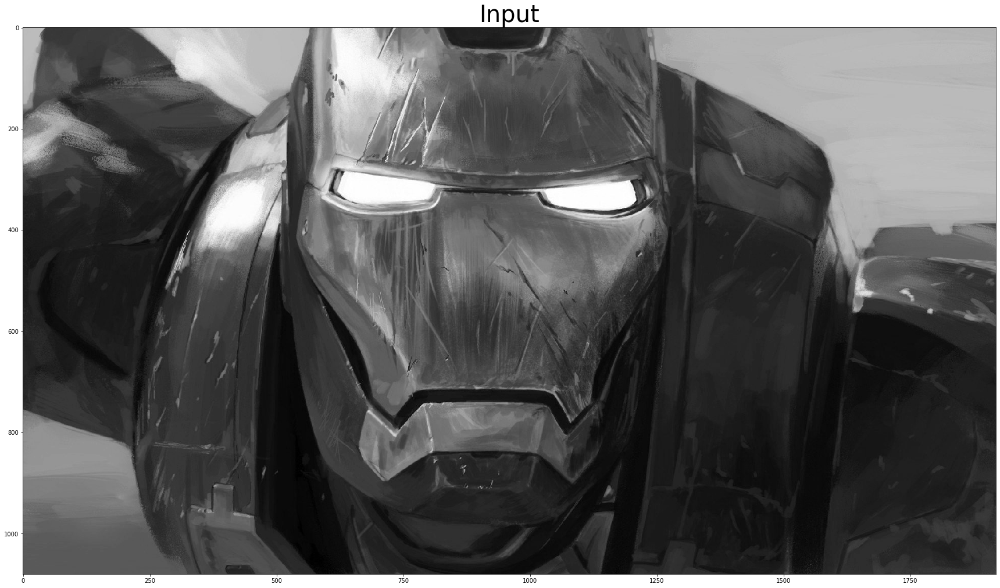

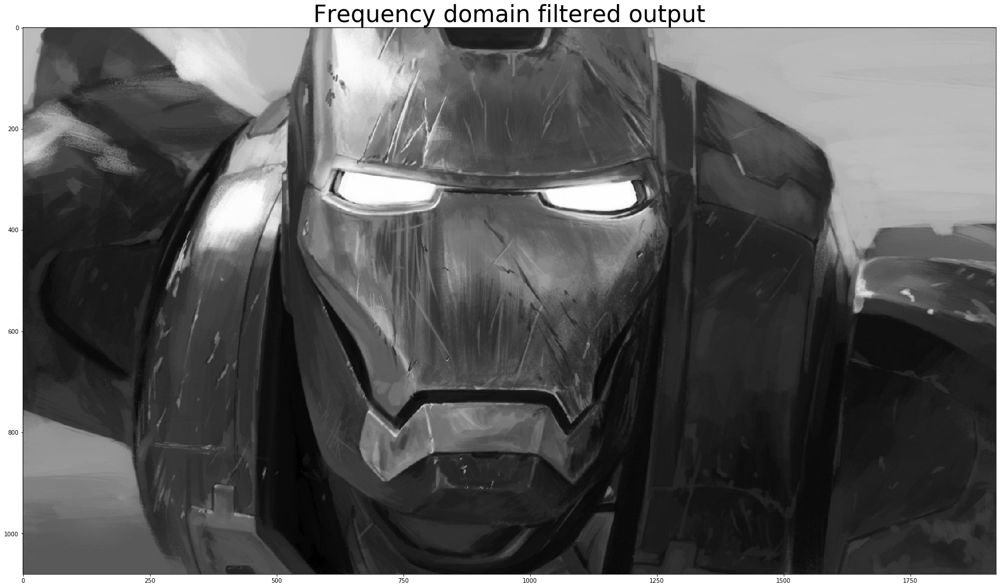

In [99]:
H = np.array([[0,1,0],[1,2,1],[0,1,0]],dtype = np.complex_)
H_spatial = np.array([[0,1,0],[1,2,1],[0,1,0]])
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/ironman.jpg')
ironman = rgb2gray(imread(file))
H_fft = fftshift(fft2(H,ironman.shape))

ironman_freq =(ifft2(ifftshift(np.multiply(fftshift(fft2(ironman)),H_fft))))

plt.figure(figsize = [30,30])
plt.imshow(ironman, 'gray')
plt.title('Input', fontsize = 40)
plt.figure(figsize = [30,30])
plt.imshow(np.abs(ironman_freq), 'gray')
plt.title('Frequency domain filtered output', fontsize = 40)
plt.show()

In [100]:
ironman_freq_fft = fftshift(fft2(ironman_freq))
ironman_fft = fftshift(fft2(ironman))

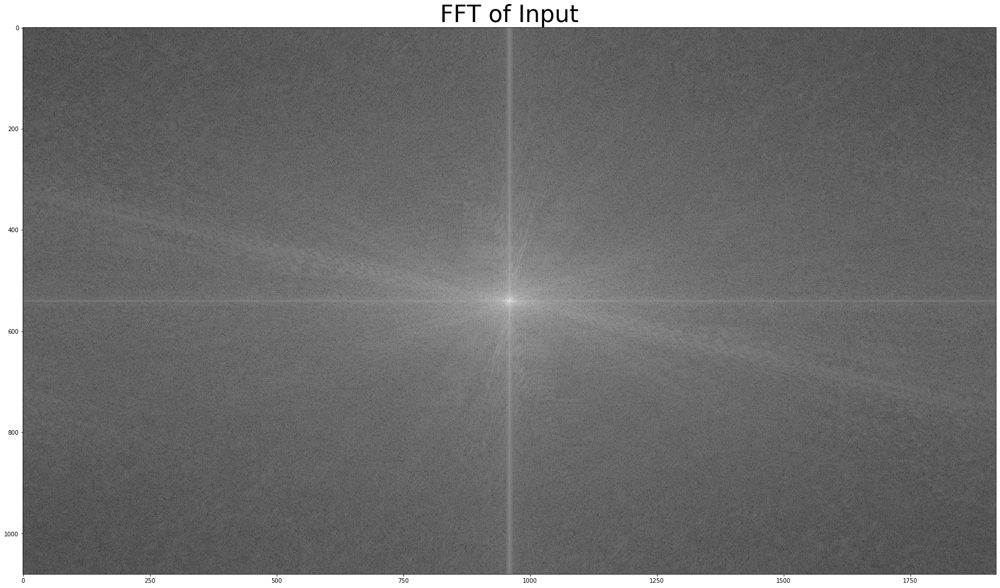

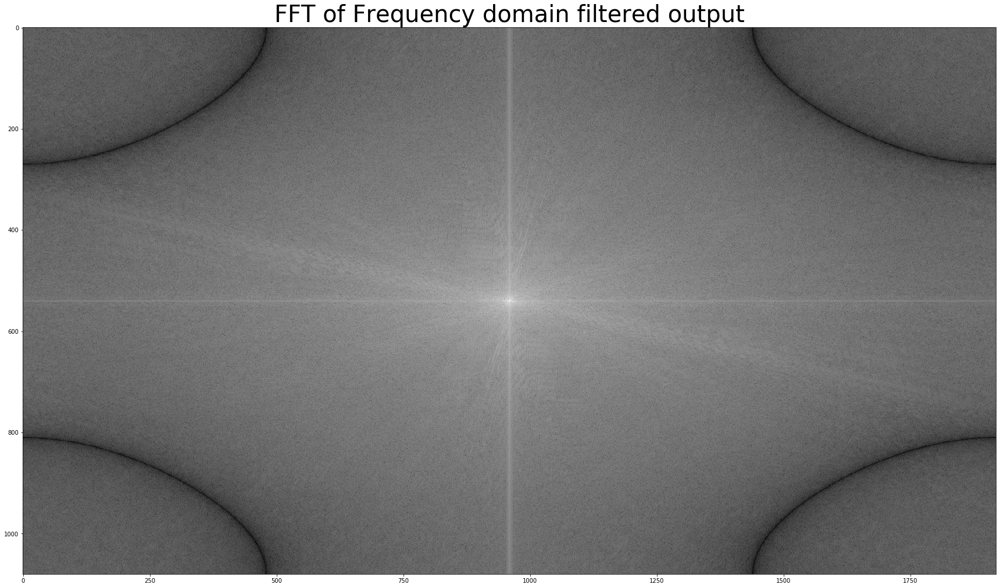

In [101]:
plt.figure(figsize = [30,30])
plt.imshow(20*np.log(1+np.abs(ironman_fft)), 'gray')
plt.title('FFT of Input', fontsize = 40)
plt.figure(figsize = [30,30])
plt.imshow(20*np.log(1+np.abs(ironman_freq_fft)), 'gray')
plt.title('FFT of Frequency domain filtered output', fontsize = 40)
plt.show()

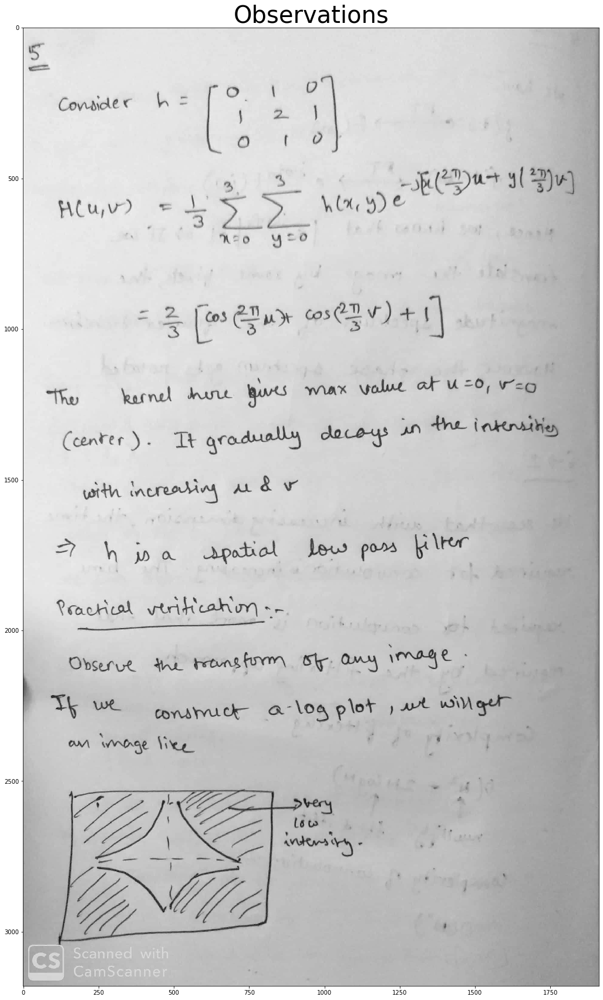

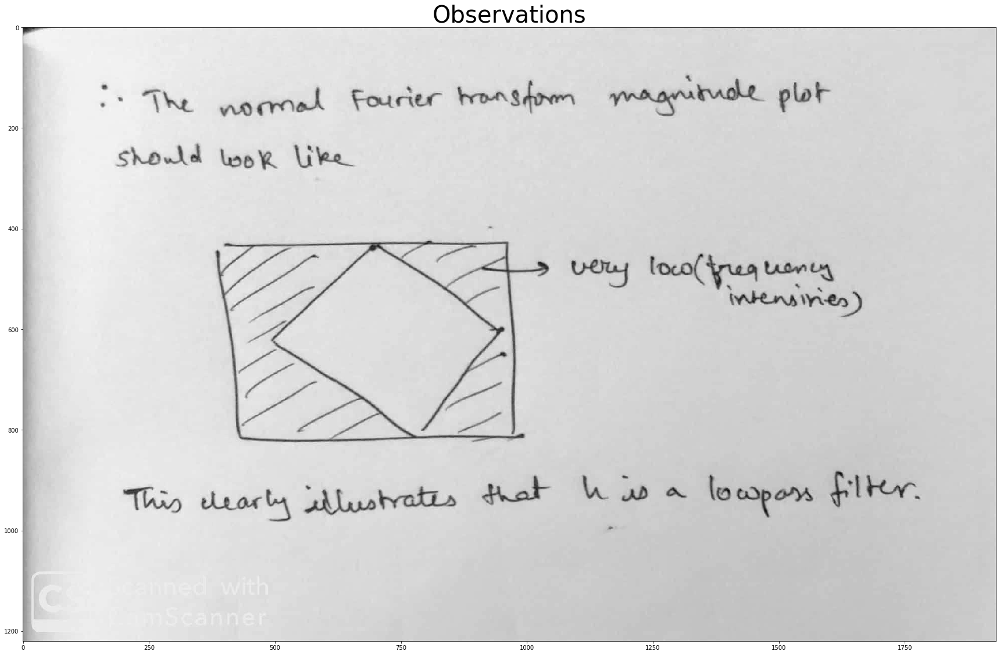

In [130]:
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/dipa3q5_1.jpg')
dipa3q5_1 = rgb2gray(imread(file))
plt.figure(figsize = [30,30])
plt.imshow(dipa3q5_1, cmap = 'gray')
plt.title('Observations', fontsize = 40)
plt.show()
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/dipa3q5_2.jpg')
dipa3q5_2 = rgb2gray(imread(file))
plt.figure(figsize = [30,30])
plt.imshow(dipa3q5_2, cmap = 'gray')
plt.title('Observations', fontsize = 40)
plt.show()

## Question 6

**Part - 1** *Pick images f and h of different dimensions, each not necessarily square, and verify the convolution theorem (DFT [f ∗ h] = F z H z , where Fz
and H z are the 2D-DFT of the images f z , h z , with f z , h z being the images f and
h,with appropriate zero-padding).*

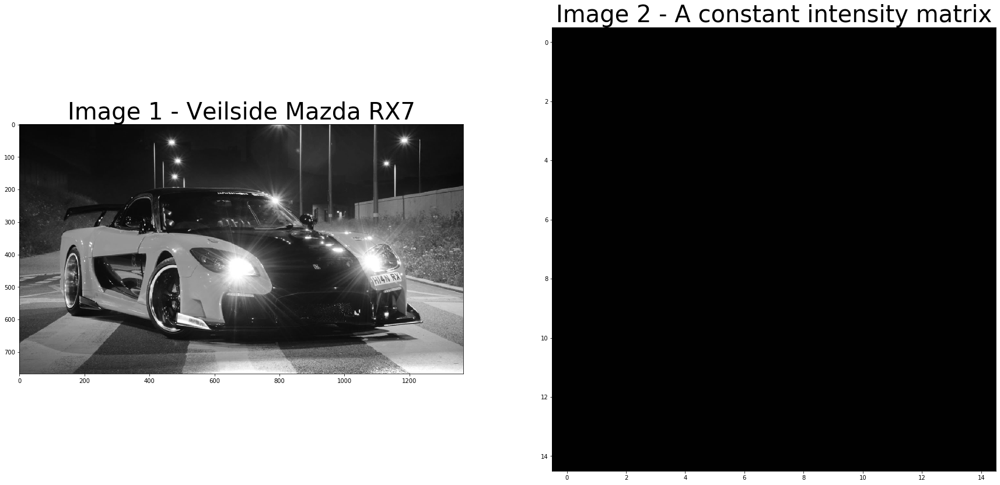

In [102]:
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/mazdarx7.jpg')
mazdarx7 = np.round(rgb2gray(imread(file))).astype('uint8')
k = 15
filtsize = np.array([k,k]).T
average_filt = np.ones(filtsize)/(filtsize[0]*filtsize[1])
fig = plt.figure(figsize = [30,30])
ax1 = fig.add_subplot(121)
ax2 = fig.add_subplot(122)
ax1.imshow(mazdarx7,'gray')
ax1.set_title('Image 1 - Veilside Mazda RX7', fontsize = 40)
ax2.imshow((average_filt).astype('float'), interpolation = 'none', cmap = 'gray', vmin = 0, vmax = 1)
ax2.set_title('Image 2 - A constant intensity matrix', fontsize = 40)
plt.show()

DFT of f*h = DFT(f)*DFT(h)


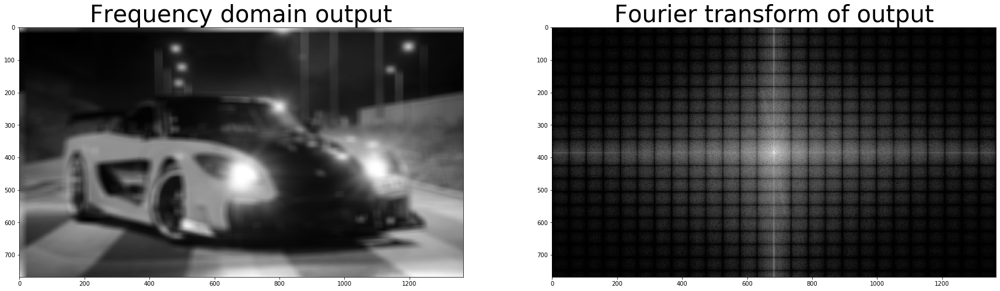

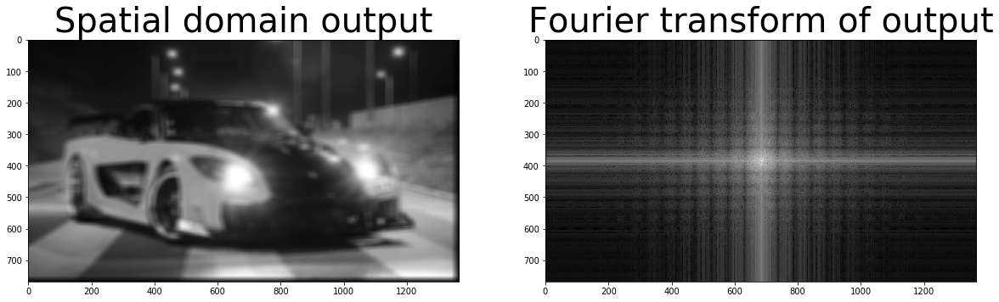

In [111]:
startfreqtime = time()
F = fftshift(fft2(rgb2gray(mazdarx7)))
H = fftshift(fft2(average_filt, rgb2gray(mazdarx7).shape))
freq_filt_fft = np.multiply(F,H)
freqfilt = ifft2(ifftshift(freq_filt_fft))
endfreqtime = time()
freqtime = endfreqtime-startfreqtime

startconvtime = time()
spatialfilt = filter2D(rgb2gray(mazdarx7), average_filt)
spatialfilt_fft = fftshift(fft2(spatialfilt))
endconvtime = time()
convtime = endconvtime-startconvtime

fig1 = plt.figure(figsize = [30,30])
ax1 = fig1.add_subplot(121)
ax2 = fig1.add_subplot(122)
ax1.imshow(np.abs(freqfilt),'gray')
ax1.set_title('Frequency domain output', fontsize = 40)
ax2.imshow(20*np.log(1+np.abs(freq_filt_fft)),'gray')
ax2.set_title('Fourier transform of output', fontsize = 40)


fig2 = plt.figure(figsize = [20,20])
ax1 = fig2.add_subplot(121)
ax2 = fig2.add_subplot(122)
ax1.imshow(spatialfilt, 'gray')
ax1.set_title('Spatial domain output', fontsize = 40)
ax2.imshow(20*np.log(1+np.abs(spatialfilt_fft)),'gray')
ax2.set_title('Fourier transform of output', fontsize = 40)

rmse = sqrt(np.mean(np.abs((20*np.log(1+np.abs(spatialfilt_fft))-20*np.log(1+np.abs(freq_filt_fft)))**2)))
if (rmse<30):
    print('DFT of f*h = DFT(f)*DFT(h)')
    
plt.show()

**Part - 2** *In the above question, find the time required to compute the convolution
directly (using conv2) and using the DFT (find F e , H e after zero-padding, multiply
point-wise, and take inverse DFT). Use matlab functions (tic, toc, cputime) for
calculating the time required for your operations. What are your observations for
various different dimensions of f, h ?*

In [104]:
print('For previous question')
print('Time required for frequency domain filtering = ',freqtime)
print('Time required for convolution based filtering = ',convtime)
print('-----------------------------------------------------------------------')
## to change dimension

convtime = []
freqtime = []
for i in range(3,20):
    k = i
    size_y = np.random.randint(10)
    filtsize = np.array([k, k+size_y ]).T
    print('Size of image 2 =  ',filtsize)
    average_filt = np.ones(filtsize)/(filtsize[0]*filtsize[1])
    
    startfreqtime = time()
    F = fftshift(fft2(rgb2gray(mazdarx7)))
    H = fftshift(fft2(average_filt, rgb2gray(mazdarx7).shape))
    freq_filt_fft = np.multiply(F,H)
    freqfilt = ifft2(freq_filt_fft)
    endfreqtime = time()
    freqtime.append(endfreqtime-startfreqtime)

    startconvtime = time()
    spatialfilt = filter2D(rgb2gray(mazdarx7), average_filt)
    spatialfilt_fft = fftshift(fft2(spatialfilt))
    endconvtime = time()
    convtime.append(endconvtime-startconvtime)
    
    print('Time required for frequency domain filtering = ',freqtime[i-3])
    print('Time required for convolution based filtering = ',convtime[i-3])
    print('-----------------------------------------------------------------')

For previous question
Time required for frequency domain filtering =  1.6278982162475586
Time required for convolution based filtering =  6.977983713150024
-----------------------------------------------------------------------
Size of image 2 =   [ 3 12]
Time required for frequency domain filtering =  1.7186188697814941
Time required for convolution based filtering =  6.9367475509643555
-----------------------------------------------------------------
Size of image 2 =   [4 7]
Time required for frequency domain filtering =  1.7664380073547363
Time required for convolution based filtering =  7.3126420974731445
-----------------------------------------------------------------
Size of image 2 =   [5 5]
Time required for frequency domain filtering =  1.7502191066741943
Time required for convolution based filtering =  6.7116923332214355
-----------------------------------------------------------------
Size of image 2 =   [ 6 12]
Time required for frequency domain filtering =  1.73253917694

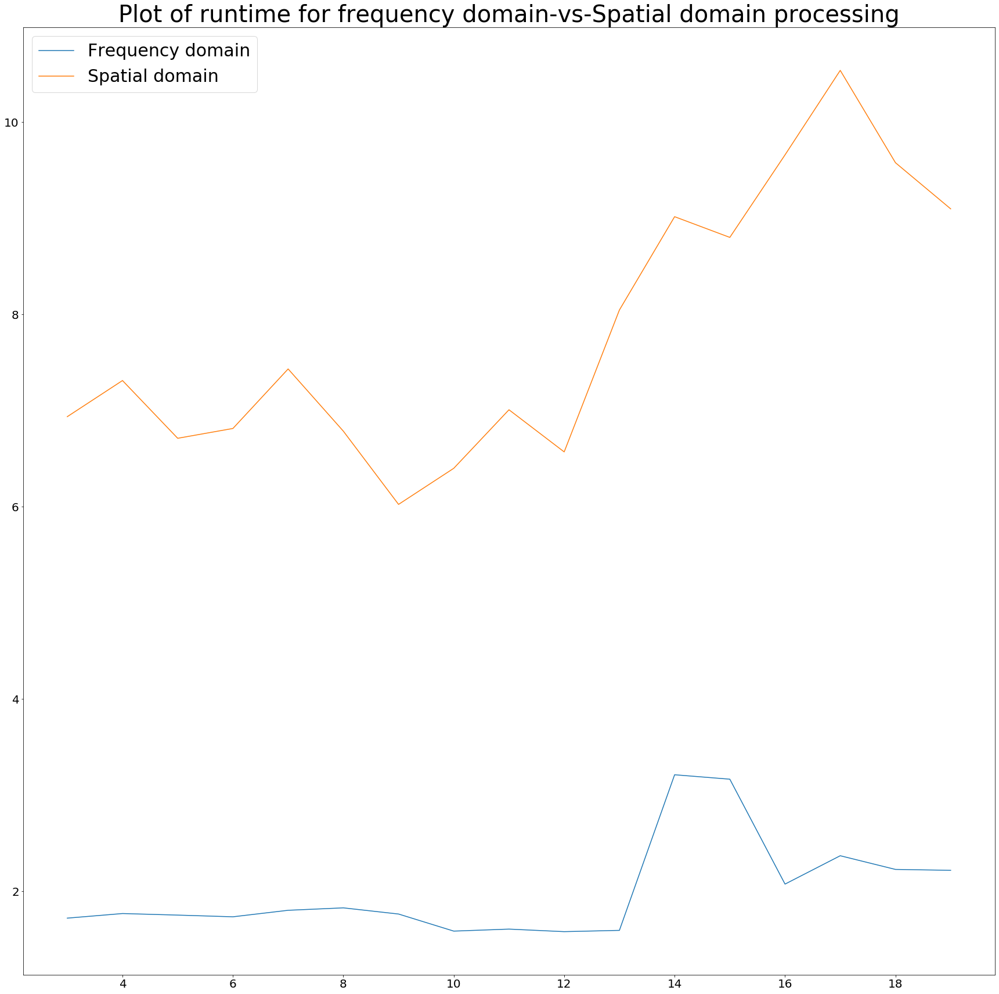

In [105]:
fig = plt.figure(figsize = [30,30])
ax = fig.add_subplot(111)
ax.plot(range(3,20),freqtime, label = 'Frequency domain')
ax.plot(range(3,20),convtime, label = 'Spatial domain')
ax.set_title('Plot of runtime for frequency domain-vs-Spatial domain processing', fontsize = 40)
ax.tick_params(axis='both', which='major', labelsize=20)
ax.tick_params(axis='both', which='minor', labelsize=50)
ax.legend(prop={'size': 30})
plt.show()

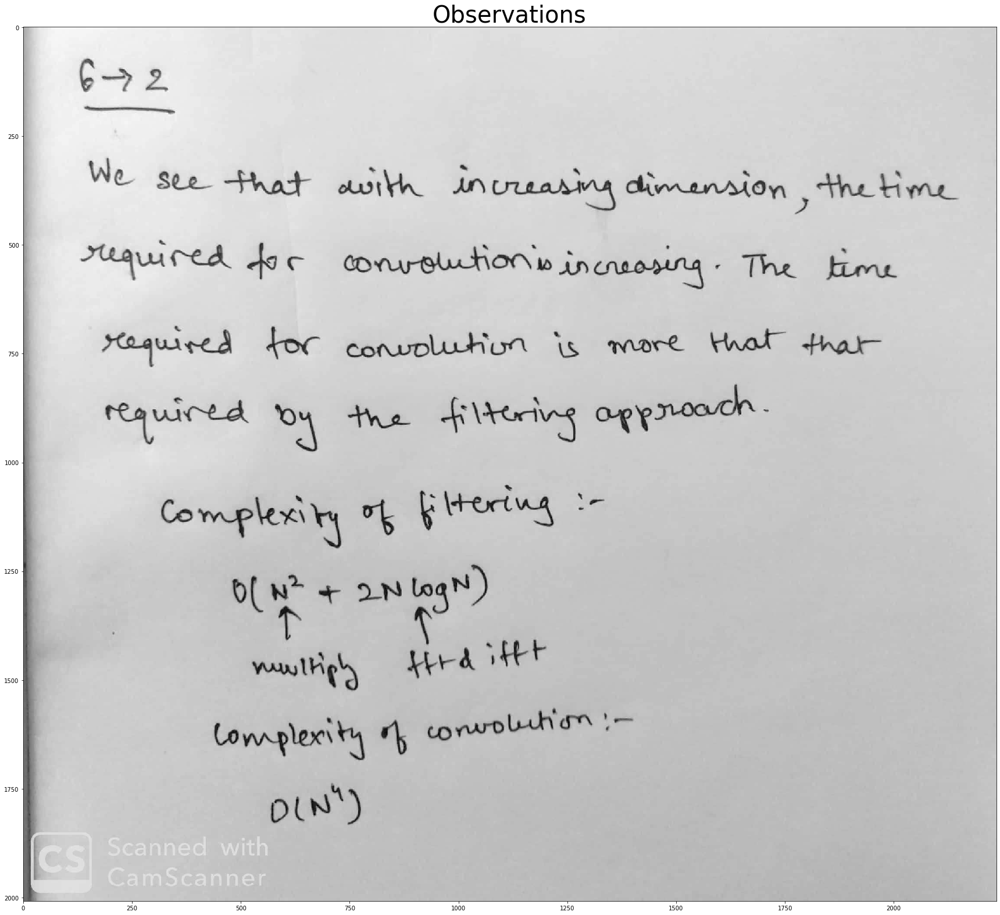

In [115]:
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/dipa3q6_2.jpg')
dipa3q6_2 = rgb2gray(imread(file))
plt.figure(figsize = [30,30])
plt.imshow(dipa3q6_2, cmap = 'gray')
plt.title('Observations', fontsize = 40)
plt.show()

## Question 7

*Aliasing can arise when you sample a continuous function or an image. The
minimum sampling rate to avoid aliasing is called the nyquist rate.*

**Part - 1** *Sample this image at different spatial sampling frequencies n x , n y . Find the nyquist
rate for the grayscale version of the image bricks.jpg*

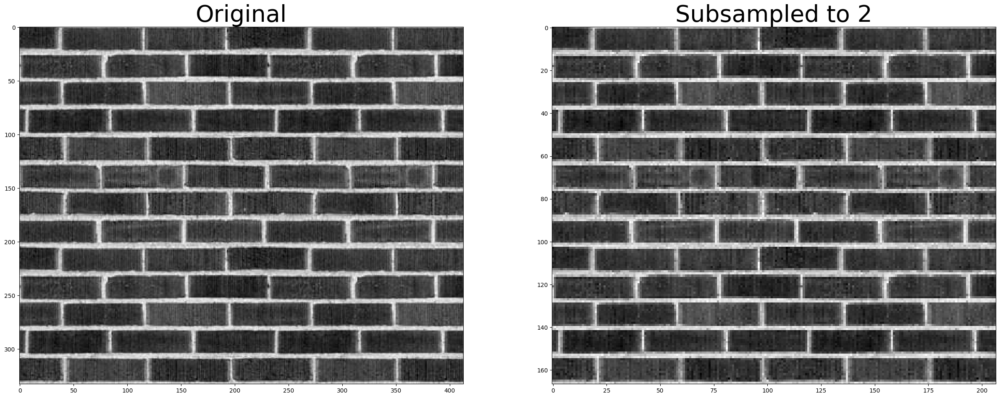

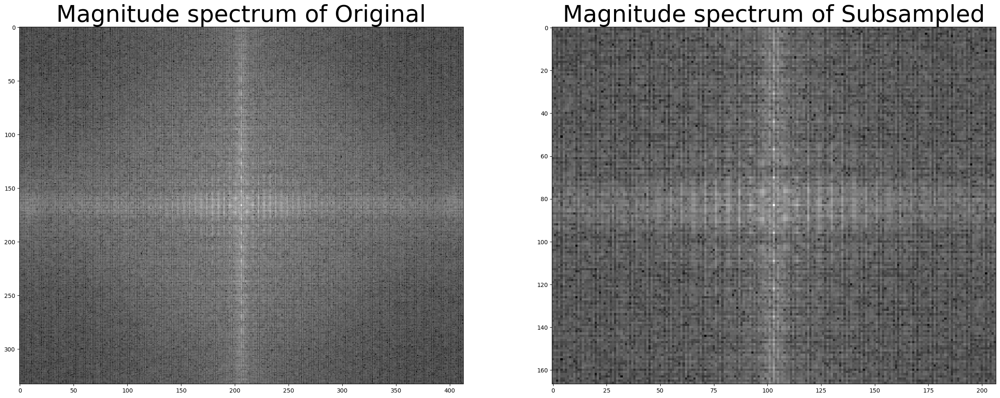

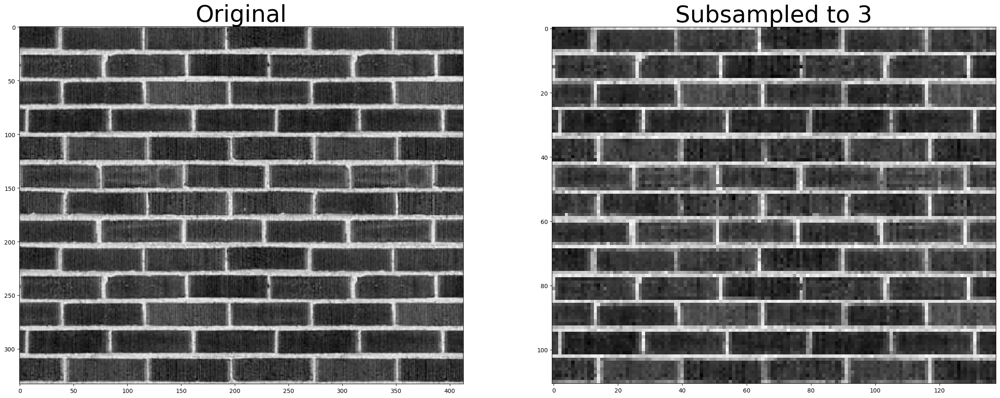

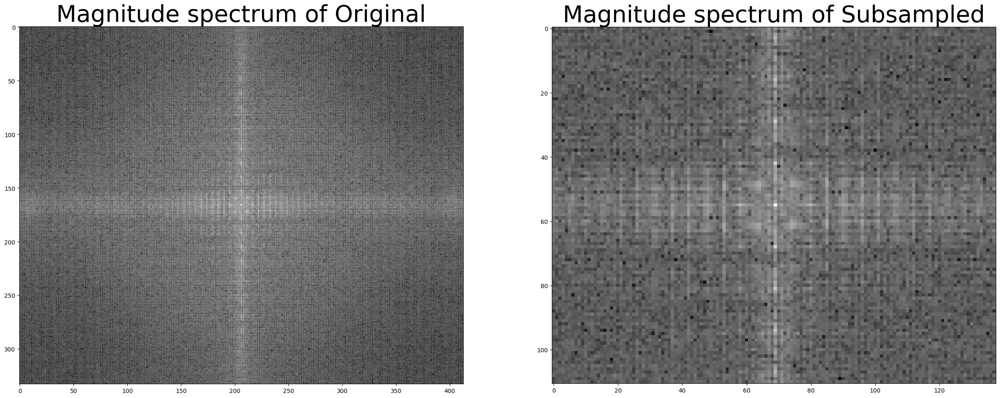

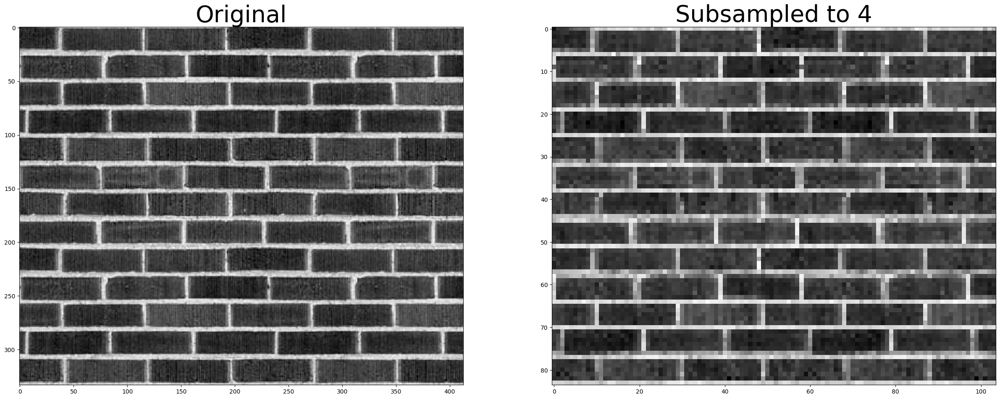

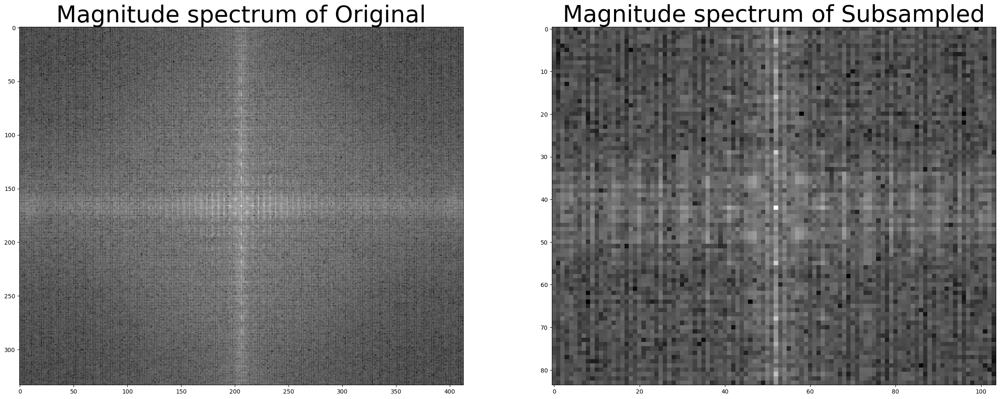

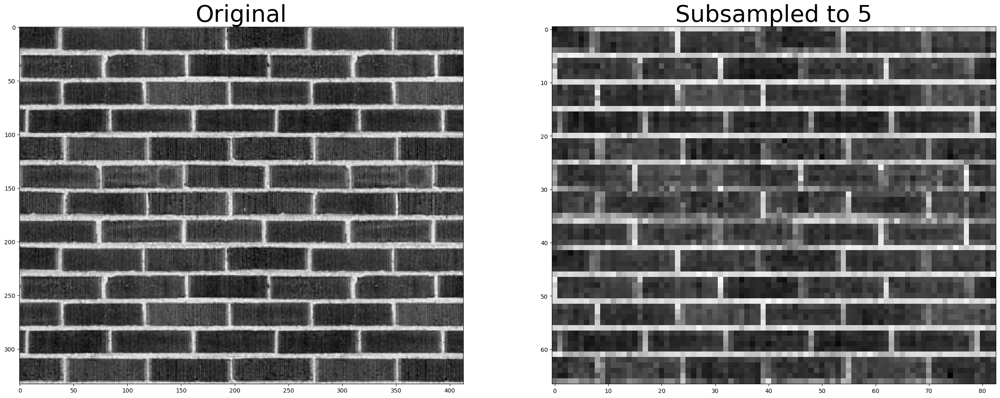

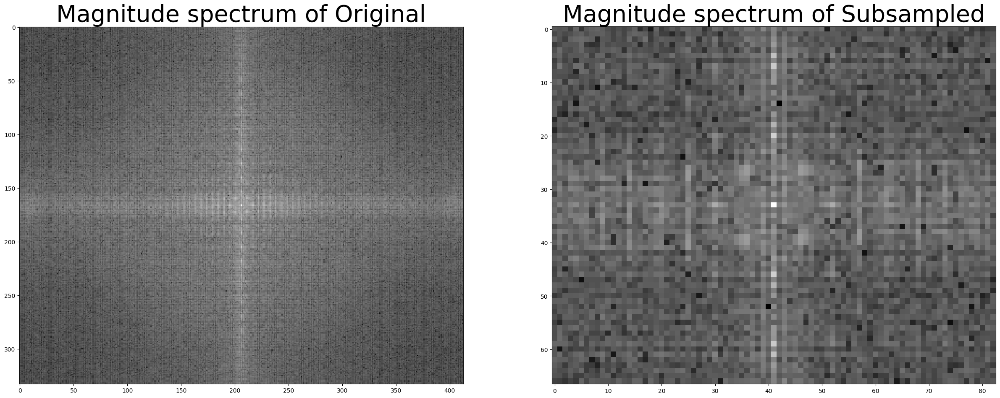

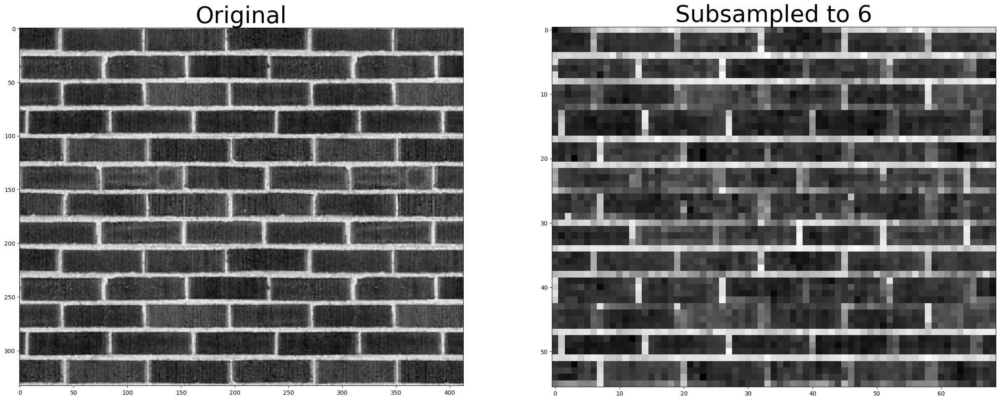

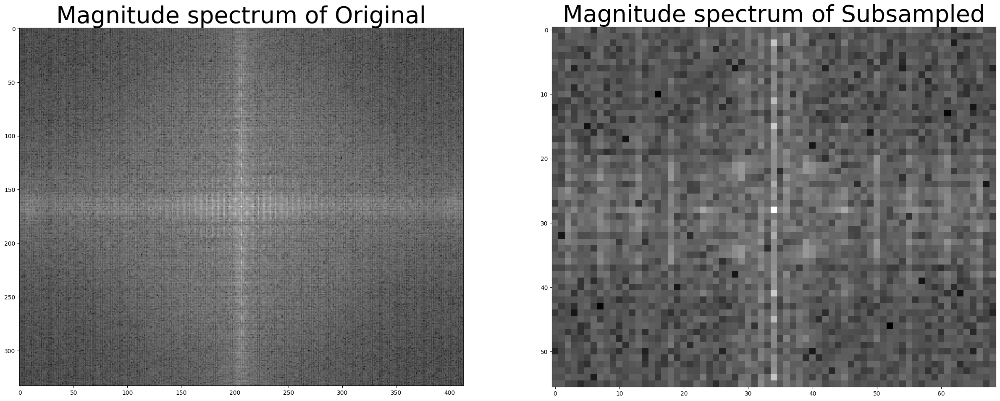

In [156]:
# nx = 175
# ny = 215
bricks = rgb2gray(bricks)
# print(bricks.shape)
for i in range(2,7,1):
    nx = i
    ny = i
    brick_down = bricks[0::nx,0::ny]
    fig1 = plt.figure(figsize = [30,30], dpi = 100)
    ax1 = fig1.add_subplot(121)
    ax1.imshow(bricks, cmap = 'gray')
    ax1.set_title('Original', fontsize = 40)
    ax2 = fig1.add_subplot(122)
    ax2.imshow(brick_down, cmap='gray')
    ax2.set_title('Subsampled to %i'%i, fontsize = 40)
    fft_bricks = fftshift(fft2(bricks))
    fig2 = plt.figure(figsize = [30,30], dpi = 100)
    ax1 = fig2.add_subplot(121)
    ax1.imshow(20*np.log(1+np.abs(fft_bricks)),cmap = 'gray')
    ax2 = fig2.add_subplot(122)
    ax2.imshow(20*np.log(1+np.abs(fftshift(fft2(brick_down)))),cmap = 'gray')
    ax1.set_title('Magnitude spectrum of Original', fontsize = 40)
    ax2.set_title('Magnitude spectrum of Subsampled', fontsize = 40)
    plt.show()

* Here in the above set of images we see that there is a spectrum repetition on and beyond sampling rate = 5
* This is also at the rate beyond which we cannot recover the original image
* Therefore nyquist rate is `4`

**Part - 2** *Investigate the effect of blurring the image on the nyquist rate.
Show intermediate results wherever relevant.*

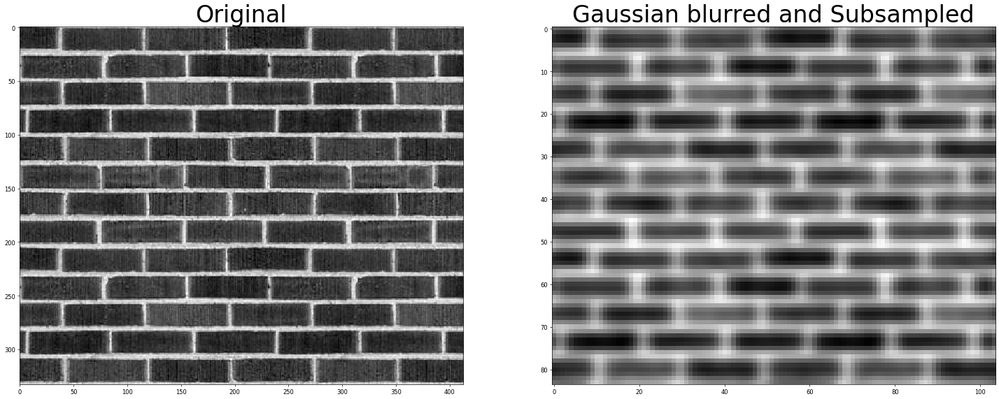

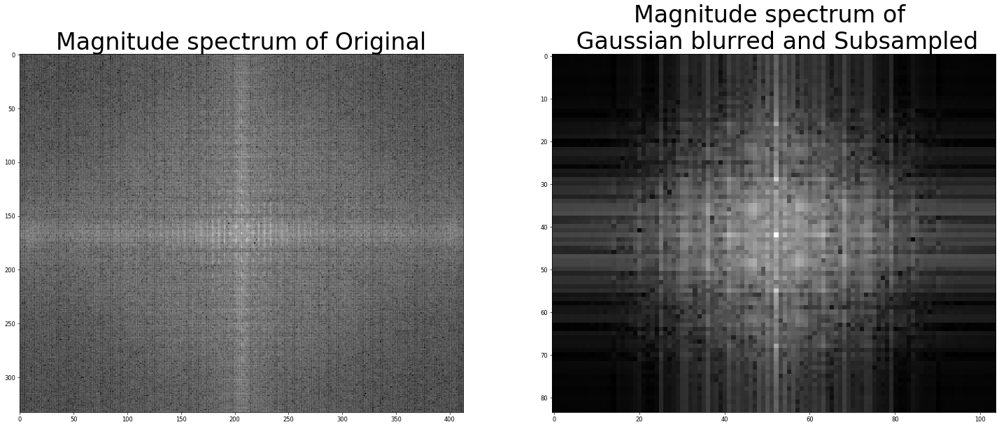

In [155]:
nx = 4
ny = 4
bricks = rgb2gray(bricks)
gauss_bricks = np.abs(gausslow2D(bricks, 12))
brick_down = gauss_bricks[0::nx,0::ny]
fig1 = plt.figure(figsize = [30,30],dpi = 60)
ax1 = fig1.add_subplot(121)
ax1.imshow(bricks, cmap = 'gray')
ax2 = fig1.add_subplot(122)
ax2.imshow(brick_down, cmap='gray')
ax1.set_title('Original', fontsize = 40)
ax2.set_title('Gaussian blurred and Subsampled', fontsize = 40)
fft_bricks = fftshift(fft2(bricks))
fig2 = plt.figure(figsize = [30,30],dpi = 60)
ax1 = fig2.add_subplot(121)
ax1.imshow(20*np.log(1+np.abs(fft_bricks)),cmap = 'gray')
ax2 = fig2.add_subplot(122)
ax2.imshow(20*np.log(1+np.abs(fftshift(fft2(brick_down)))),cmap = 'gray')
ax1.set_title('Magnitude spectrum of Original', fontsize = 40)
ax2.set_title('Magnitude spectrum of \n Gaussian blurred and Subsampled', fontsize = 40)
plt.show()

## Question 8

**Part - 1** *Compute the FFT of the image rectangle.jpg. Now rotate the image in spatial domain and compute the FFT of the rotated image. Report your
observations and justify it mathematically.*

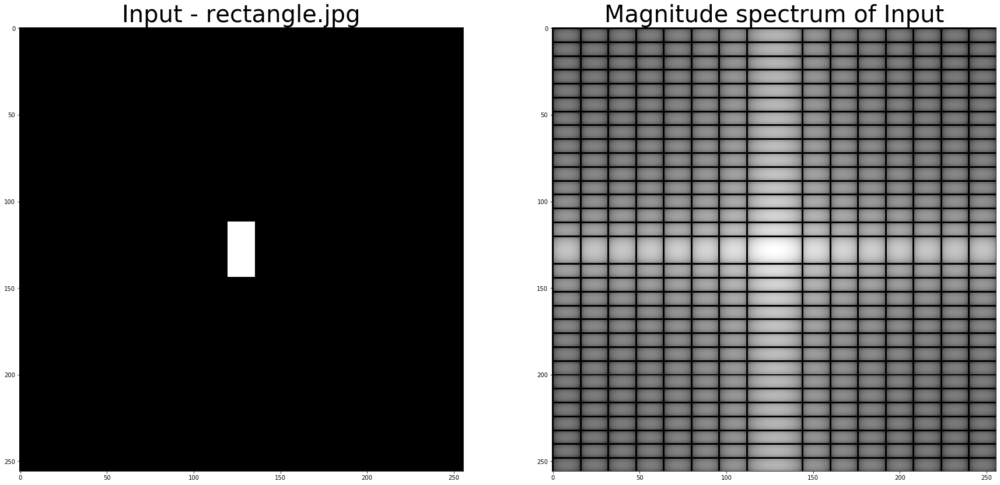

In [108]:
rect_fft = fftshift(fft2(rgb2gray(rectangle)))
fig = plt.figure(figsize = [30,30])
ax1 = fig.add_subplot(121)
ax1.imshow(rgb2gray(rectangle), cmap = 'gray')
ax2 = fig.add_subplot(122)
ax2.imshow(np.log(1+np.abs(rect_fft)), cmap='gray')
ax1.set_title('Input - rectangle.jpg', fontsize = 40)
ax2.set_title('Magnitude spectrum of Input', fontsize = 40)
plt.show()

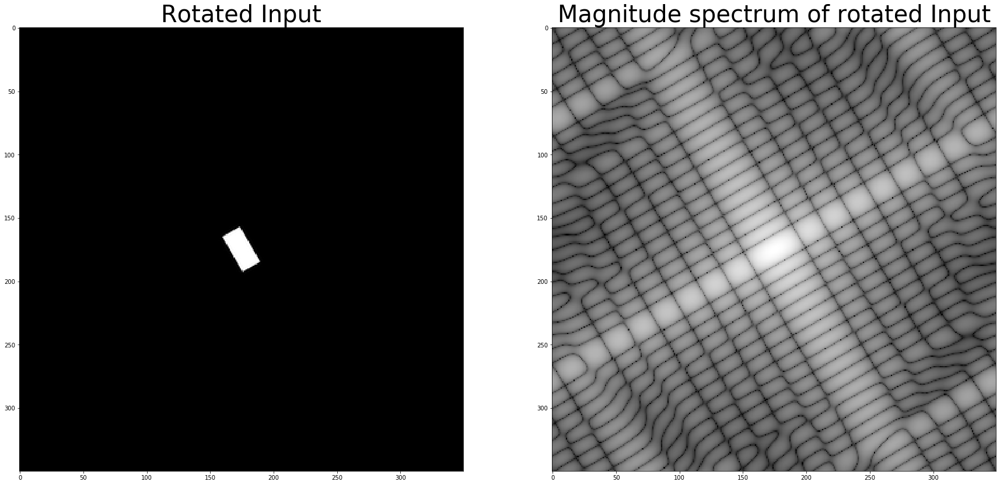

In [109]:
degree = 30
rect_rot = rotate(rgb2gray(rectangle), angle = degree)
rect_rot_fft = fftshift(fft2(rect_rot))
fig = plt.figure(figsize = [30,30])
ax1 = fig.add_subplot(121)
ax1.imshow(rect_rot, cmap = 'gray')
ax2 = fig.add_subplot(122)
ax2.imshow(np.log(1+np.abs(rect_rot_fft)), cmap='gray')
ax1.set_title('Rotated Input', fontsize = 40)
ax2.set_title('Magnitude spectrum of rotated Input', fontsize = 40)
plt.show()

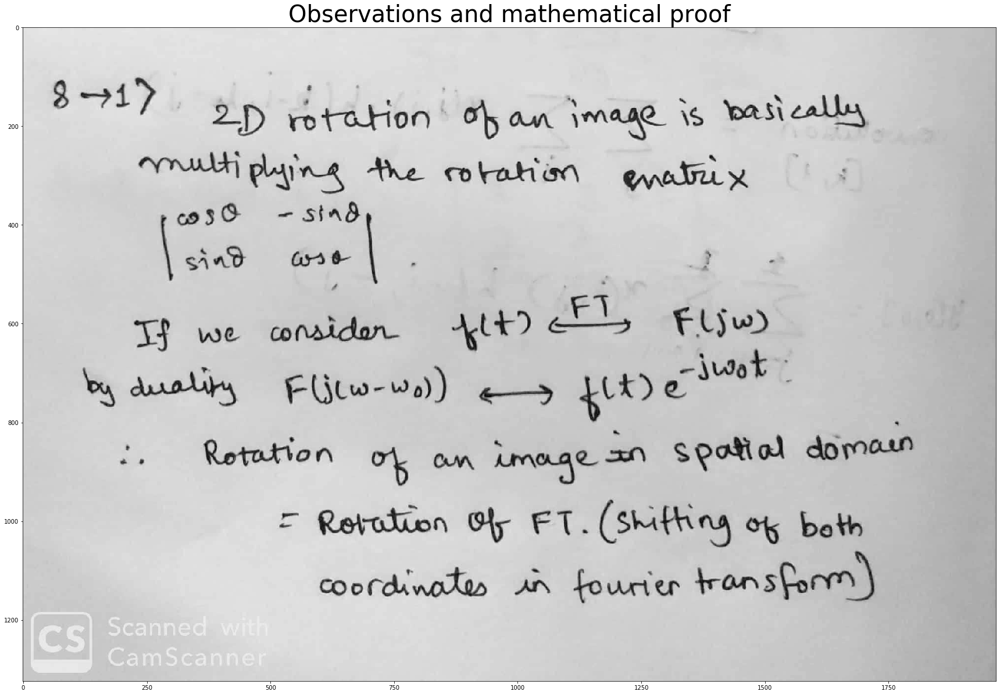

In [119]:
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/dipa3q8_1.jpg')
dipa3q8_1 = rgb2gray(imread(file))
plt.figure(figsize = [30,30])
plt.imshow(dipa3q8_1, cmap = 'gray')
plt.title('Observations and mathematical proof', fontsize = 40)
plt.show()

**Part - 2** *Take the image rectangle.jpg and translate the image by few pixels Find the
FFT of original and translated images. Report your observations and justify it
mathematically.*

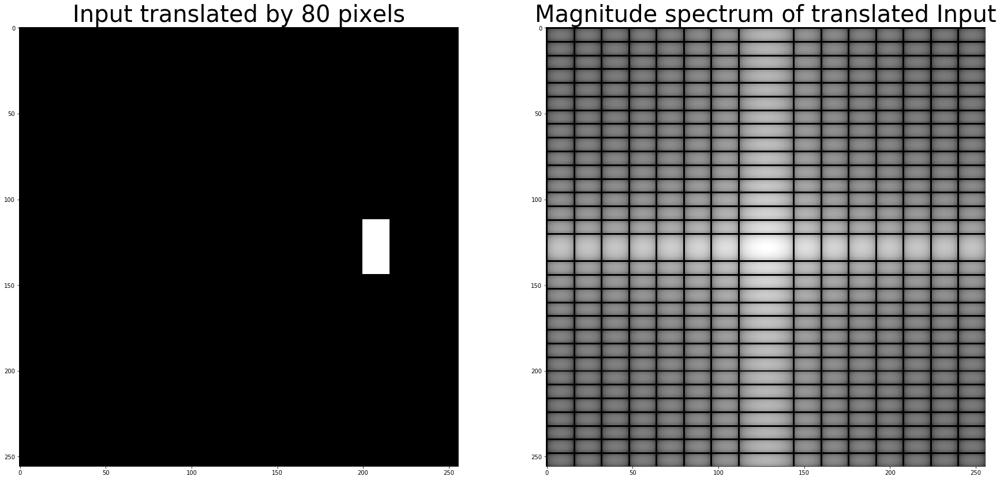

In [110]:
rect_translate = np.zeros(rectangle.shape)
pix_shift = 80
rect_translate[:,pix_shift:rectangle.shape[1]] = rectangle[:,0:rectangle.shape[1]-pix_shift]
rect_translate[:,0:pix_shift] = rectangle[:,rectangle.shape[1]-pix_shift:rectangle.shape[1]]
rect_translate_fft = fftshift(fft2(rect_translate))
fig = plt.figure(figsize = [30,30])
ax1 = fig.add_subplot(121)
ax1.imshow(rect_translate, cmap = 'gray')
ax2 = fig.add_subplot(122)
ax2.imshow(np.log(1+np.abs(rect_translate_fft)), cmap='gray')
ax1.set_title('Input translated by %i pixels'%pix_shift, fontsize = 40)
ax2.set_title('Magnitude spectrum of translated Input', fontsize = 40)
plt.show()

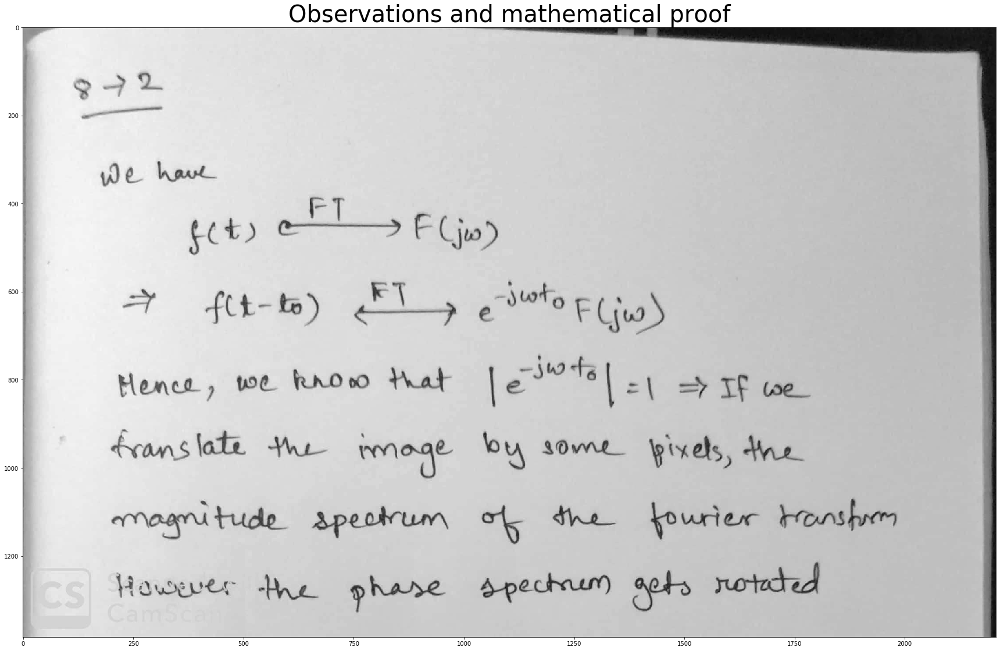

In [120]:
file = os.path.join(os.getcwd(), 'A3_resources/DIP_2019_A3/dipa3q8_2.jpg')
dipa3q8_2 = rgb2gray(imread(file))
plt.figure(figsize = [30,30])
plt.imshow(dipa3q8_2, cmap = 'gray')
plt.title('Observations and mathematical proof', fontsize = 40)
plt.show()